# Clustering Techniques

Apply Kmeans, AgglomerativeClustering, and DBSCAN to data with different preprocessing steps:

1. Simple Processed data: clean data and removing null values
2. Log transformed data: apply log transformation to handle the skenwess of data
3. Standard Scalar + Log transformed Data
4. MinMax Scalar + Log Transformed Data
5. MinMax Scalar + Log Transform + PCA Data
6. MinMAx Scalar + Log Transform + Kernel PCA Data
7. Log Transformed data + PCA
8. Log Transformed Data + Kernel PCA

In [1]:
#general data path
DATA_PATH="../data/CC GENERAL.csv"
#simple preprocessing
PROCESSED_DATA_PATH="../data/processed_data.csv"
# log transformation
LOG_TRANSFORMED_DATA="../data/log_transformed_data.csv"
# standard scalar
STANDARD_DATA_PATH="../data/standard_data.csv"
# standard scalar + log transformation
STANDARD_LOG_DATA_PATH="../data/standard_log_data.csv"
# minmax scaling
MINMAXSCALAR_DATA_PATH="../data/minmaxscalar_data.csv"
# Rpboust scaling 
ROBUSTSCALAR_DATA_PATH="../data/Robustscalar_data.csv"
#minmax scaling + log transform
MINMAXSCALAR_LOG_DATA_PATH="../data/minmaxscalar_log_data.csv"
# Rpboust scaling + log transform
ROBUSTSCALAR_LOG_DATA_PATH="../data/Robustscalar_log_data.csv"
#  Log transform  + pca
LOG_DATA_PCA="../data/log_data_PCA.csv"
# log transform + kernel pca
LOG_DATA_KERNEL_PCA="../data/log_data_kernelPCA.csv"
# MinMax scalar+ Log transform  + pca
DATA_PCA="../data/data_PCA.csv"
# MinMax scalar+log transform + kernel pca
DATA_KERNEL_PCA="../data/data_kernelPCA.csv"

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
from plotnine import *


from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import scipy.cluster.hierarchy as shc
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors

from sklearn.metrics import silhouette_score


------------

# 1. Simple Processed data

### 1.2 Read data

In [3]:
process_data=pd.read_csv(PROCESSED_DATA_PATH)
process_data.shape

(8950, 17)

In [4]:
# visualize with TSNE
tsne=TSNE(n_components=2,perplexity=30, verbose=1, n_iter=300 )
processed_tsne_projection= tsne.fit_transform(process_data)
processed_tsne_projection = pd.DataFrame(processed_tsne_projection, index=process_data.index)
processed_tsne_projection.shape

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 8950 samples in 0.002s...
[t-SNE] Computed neighbors for 8950 samples in 18.883s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8950
[t-SNE] Computed conditional probabilities for sample 2000 / 8950
[t-SNE] Computed conditional probabilities for sample 3000 / 8950
[t-SNE] Computed conditional probabilities for sample 4000 / 8950
[t-SNE] Computed conditional probabilities for sample 5000 / 8950
[t-SNE] Computed conditional probabilities for sample 6000 / 8950
[t-SNE] Computed conditional probabilities for sample 7000 / 8950
[t-SNE] Computed conditional probabilities for sample 8000 / 8950
[t-SNE] Computed conditional probabilities for sample 8950 / 8950
[t-SNE] Mean sigma: 84.766948
[t-SNE] KL divergence after 250 iterations with early exaggeration: 80.270668
[t-SNE] KL divergence after 300 iterations: 2.585277


(8950, 2)

### 1.2 Apply Kmeans

In [5]:
KMean=KMeans(n_clusters=7, n_init=1,max_iter=100)
KMean.fit(process_data)
pd.DataFrame(KMean.labels_).value_counts()

0    5277
5    2281
2     806
6     392
1     115
4      56
3      23
dtype: int64

In [6]:
silhouette_score(process_data, KMean.fit_predict(process_data))

0.35548658993116433

In [7]:
processed_tsne_projection['kmeans label']=KMean.labels_
processed_tsne_projection['kmeans label'].replace(0, "cluster 1", inplace=True)
processed_tsne_projection['kmeans label'].replace(1, "cluster 2", inplace=True)
processed_tsne_projection['kmeans label'].replace(2, "cluster 3", inplace=True)
processed_tsne_projection['kmeans label'].replace(3, "cluster 4", inplace=True)
processed_tsne_projection['kmeans label'].replace(4, "cluster 5", inplace=True)
processed_tsne_projection['kmeans label'].replace(5, "cluster 6", inplace=True)
processed_tsne_projection['kmeans label'].replace(6, "cluster 7", inplace=True)
processed_tsne_projection.head()

,0,1,kmeans label
0,12.414211,-1.172660,cluster 1
1,0.724377,-8.777986,cluster 4
2,-7.344095,-1.524589,cluster 7
3,-7.349075,0.769226,cluster 7
4,9.158696,5.450480,cluster 1


In [8]:
fig=px.scatter(x=processed_tsne_projection[0], y=processed_tsne_projection[1],
               color=processed_tsne_projection['kmeans label'],
               color_discrete_sequence=px.colors.qualitative.T10
              )
fig.update_layout( title_text='Simple Processing + Kmeans , number of clusters=7 ')
fig.show()

### 1.3 AgglomerativeClustering

In [9]:
# plt.figure(figsize=(10, 7))
# plt.title("Counters Dendograms")
# dend = shc.dendrogram(shc.linkage(y=process_data , method='average',metric='cityblock'),orientation='right') #fill y with your dataframe
#                                                                                       #and method with linkage criteria
#                                                                                       #and metric with distance function

In [10]:
hier_cluster = AgglomerativeClustering(n_clusters=7,linkage='average',affinity='manhattan')
silhouette_score(process_data, hier_cluster.fit_predict(process_data))

0.7879335561367031

In [11]:
pd.DataFrame(hier_cluster.labels_).value_counts()

4    8917
0      21
2       5
6       3
1       2
3       1
5       1
dtype: int64

In [12]:
processed_tsne_projection['hier label']=hier_cluster.labels_
processed_tsne_projection['hier label'].replace(0, "cluster 1", inplace=True)
processed_tsne_projection['hier label'].replace(1, "cluster 2", inplace=True)
processed_tsne_projection['hier label'].replace(2, "cluster 3", inplace=True)
processed_tsne_projection['hier label'].replace(3, "cluster 4", inplace=True)
processed_tsne_projection['hier label'].replace(4, "cluster 5", inplace=True)
processed_tsne_projection['hier label'].replace(5, "cluster 6", inplace=True)
processed_tsne_projection['hier label'].replace(6, "cluster 7", inplace=True)
processed_tsne_projection.head()

,0,1,kmeans label,hier label
0,12.414211,-1.172660,cluster 1,cluster 5
1,0.724377,-8.777986,cluster 4,cluster 5
2,-7.344095,-1.524589,cluster 7,cluster 5
3,-7.349075,0.769226,cluster 7,cluster 5
4,9.158696,5.450480,cluster 1,cluster 5


In [13]:
fig=px.scatter(x=processed_tsne_projection[0], y=processed_tsne_projection[1], 
               color=processed_tsne_projection['hier label'],
               color_discrete_sequence=px.colors.qualitative.T10
              )
fig.update_layout( title_text='Simple Processing + AgglomerativeClustering , number of clusters=7 ')
fig.show()

### 1.4 DBSCAN

C:\Users\esraa\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning:

Pass n_neighbors=19 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error



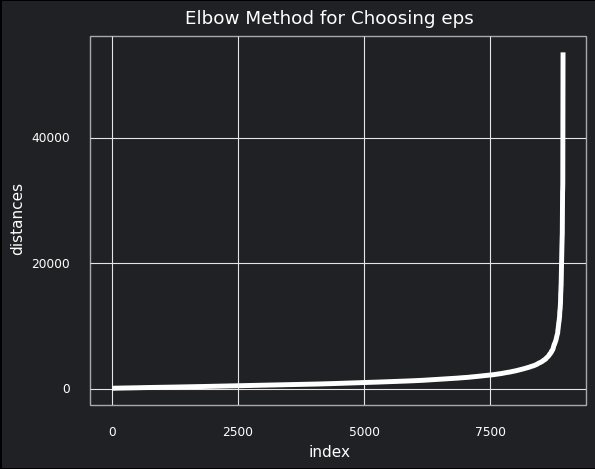

<ggplot: (144873652577)>

In [14]:
# Elbow method

mins = 18
nn = NearestNeighbors(mins + 1)

nn.fit(process_data)

distances, neighbors = nn.kneighbors(process_data)

# sort the distances
distances = np.sort(distances[:, mins], axis = 0)

#plot the distances
distances_df = pd.DataFrame({"distances": distances,
                             "index": list(range(0,len(distances)))})
plt = (ggplot(distances_df, aes(x = "index", y = "distances")) +
 geom_line(color = "white", size = 2) + theme_minimal() +
 labs(title = "Elbow Method for Choosing eps") +
 theme(panel_grid_minor = element_blank(),
      rect = element_rect(fill = "#202124ff"),
      axis_text = element_text(color = "white"),
      axis_title = element_text(color = "white"),
      plot_title = element_text(color = "white"),
      panel_border = element_line(color = "darkgray"),
      plot_background = element_rect(fill = "#202124ff")
      ))


plt

In [15]:
# entry point to min points = # features+1
process_db = DBSCAN(eps = 350, min_samples = 18).fit(process_data)
pd.DataFrame(process_db.labels_).value_counts()

-1    6591
 0    1991
 3     176
 2      78
 4      67
 1      47
dtype: int64

In [16]:
# calaculate silhout score without noise 
process_data_copy= process_data.copy()
process_data_copy["DBSCAN labels"] = process_db.labels_

# grab only clustered data points
process_data_copy_clustered = process_data_copy.loc[(process_data_copy["DBSCAN labels"] >= 0)]

silhouette_score(process_data_copy_clustered.drop("DBSCAN labels", axis=1), process_data_copy_clustered["DBSCAN labels"])



0.3969224933363841

In [17]:
processed_tsne_projection['DBSCAN label']=process_db.labels_
processed_tsne_projection['DBSCAN label'].replace(0, "cluster 1", inplace=True)
processed_tsne_projection['DBSCAN label'].replace(1, "cluster 2", inplace=True)
processed_tsne_projection['DBSCAN label'].replace(2, "cluster 3", inplace=True)
processed_tsne_projection['DBSCAN label'].replace(3, "cluster 4", inplace=True)
processed_tsne_projection['DBSCAN label'].replace(4, "cluster 5", inplace=True)
# processed_tsne_projection['DBSCAN label'].replace(6, "cluster 7", inplace=True)
# processed_tsne_projection['DBSCAN label'].replace(7, "cluster 8", inplace=True)

processed_tsne_projection['DBSCAN label'].replace(-1, "anomaly", inplace=True)

processed_tsne_projection.head()

,0,1,kmeans label,hier label,DBSCAN label
0,12.414211,-1.172660,cluster 1,cluster 5,cluster 1
1,0.724377,-8.777986,cluster 4,cluster 5,anomaly
2,-7.344095,-1.524589,cluster 7,cluster 5,anomaly
3,-7.349075,0.769226,cluster 7,cluster 5,anomaly
4,9.158696,5.450480,cluster 1,cluster 5,cluster 1


In [18]:
fig=px.scatter(x=processed_tsne_projection[0], y=processed_tsne_projection[1], 
               color=processed_tsne_projection['DBSCAN label'],
               color_discrete_sequence=px.colors.qualitative.T10
              )
fig.update_layout( title_text='Simple Processing + DBSCAN , eps = 350, min_samples = 18 ')
fig.show()

------------

# 2.  Log transformed data

### 2.1 Read data

In [19]:
log_data=pd.read_csv(LOG_TRANSFORMED_DATA)
log_data.shape

(8950, 17)

In [20]:
# visualize with TSNE
tsne=TSNE(n_components=2,perplexity=30, verbose=1, n_iter=300 )
log_tsne= tsne.fit_transform(log_data)
log_tsne = pd.DataFrame(log_tsne, index=log_data.index)
log_tsne.shape

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 8950 samples in 0.002s...
[t-SNE] Computed neighbors for 8950 samples in 6.687s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8950
[t-SNE] Computed conditional probabilities for sample 2000 / 8950
[t-SNE] Computed conditional probabilities for sample 3000 / 8950
[t-SNE] Computed conditional probabilities for sample 4000 / 8950
[t-SNE] Computed conditional probabilities for sample 5000 / 8950
[t-SNE] Computed conditional probabilities for sample 6000 / 8950
[t-SNE] Computed conditional probabilities for sample 7000 / 8950
[t-SNE] Computed conditional probabilities for sample 8000 / 8950
[t-SNE] Computed conditional probabilities for sample 8950 / 8950
[t-SNE] Mean sigma: 0.659467
[t-SNE] KL divergence after 250 iterations with early exaggeration: 71.688828
[t-SNE] KL divergence after 300 iterations: 2.428939


(8950, 2)

### 2.2 Apply Kmeans

In [21]:
KMean=KMeans(n_clusters=7, n_init=1,max_iter=100)
KMean.fit(log_data)
pd.DataFrame(KMean.labels_).value_counts()

2    2092
4    1661
0    1348
3    1114
1     987
6     970
5     778
dtype: int64

In [22]:
silhouette_score(log_data, KMean.fit_predict(log_data))

0.4560929615390284

In [23]:
log_tsne['Kmeans label']=KMean.labels_
log_tsne['Kmeans label'].replace(0, "cluster 1", inplace=True)
log_tsne['Kmeans label'].replace(1, "cluster 2", inplace=True)
log_tsne['Kmeans label'].replace(2, "cluster 3", inplace=True)
log_tsne['Kmeans label'].replace(3, "cluster 4", inplace=True)
log_tsne['Kmeans label'].replace(4, "cluster 5", inplace=True)
log_tsne['Kmeans label'].replace(5, "cluster 6", inplace=True)
log_tsne['Kmeans label'].replace(6, "cluster 7", inplace=True)
log_tsne.head()

,0,1,Kmeans label
0,-1.568094,4.714238,cluster 2
1,8.451801,0.446154,cluster 3
2,-0.053930,-11.729030,cluster 7
3,4.041708,0.943736,cluster 5
4,-5.146874,-10.742715,cluster 7


In [24]:
fig=px.scatter(x=log_tsne[0], y=log_tsne[1], 
               color=log_tsne['Kmeans label'],
               color_discrete_sequence=px.colors.qualitative.T10 )
fig.update_layout( title_text='Log transform + Kmeans, number of clusters=7')
fig.show()

### 2.3 AgglomerativeClustering

In [25]:
# plt.figure(figsize=(10, 7))
# plt.title("Counters Dendograms")
# dend = shc.dendrogram(shc.linkage(y=log_data , method='average',metric='cityblock'),orientation='right') #fill y with your dataframe
#                                                                                       #and method with linkage criteria
#                                                                                       #and metric with distance function

In [26]:
hier_cluster = AgglomerativeClustering(n_clusters=7,linkage='average',affinity='manhattan')
silhouette_score(log_data, hier_cluster.fit_predict(log_data))

0.3125077734317693

In [27]:
pd.DataFrame(hier_cluster.labels_).value_counts()

2    3557
5    2056
0    1870
1    1458
3       6
4       2
6       1
dtype: int64

In [28]:
log_tsne['hier label']=hier_cluster.labels_
log_tsne['hier label'].replace(0, "cluster 1", inplace=True)
log_tsne['hier label'].replace(1, "cluster 2", inplace=True)
log_tsne['hier label'].replace(2, "cluster 3", inplace=True)
log_tsne['hier label'].replace(3, "cluster 4", inplace=True)
log_tsne['hier label'].replace(4, "cluster 5", inplace=True)
log_tsne['hier label'].replace(5, "cluster 6", inplace=True)
log_tsne['hier label'].replace(6, "cluster 7", inplace=True)
log_tsne.head()

,0,1,Kmeans label,hier label
0,-1.568094,4.714238,cluster 2,cluster 3
1,8.451801,0.446154,cluster 3,cluster 6
2,-0.053930,-11.729030,cluster 7,cluster 1
3,4.041708,0.943736,cluster 5,cluster 1
4,-5.146874,-10.742715,cluster 7,cluster 1


In [29]:
fig=px.scatter(x=log_tsne[0], y=log_tsne[1], 
               color=log_tsne['hier label'],
               color_discrete_sequence=px.colors.qualitative.T10
              )
fig.update_layout( title_text='Log Transform + AgglomerativeClustering , number of clusters=7 ')
fig.show()

### 2.4 DBSCAN

C:\Users\esraa\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning:

Pass n_neighbors=19 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error



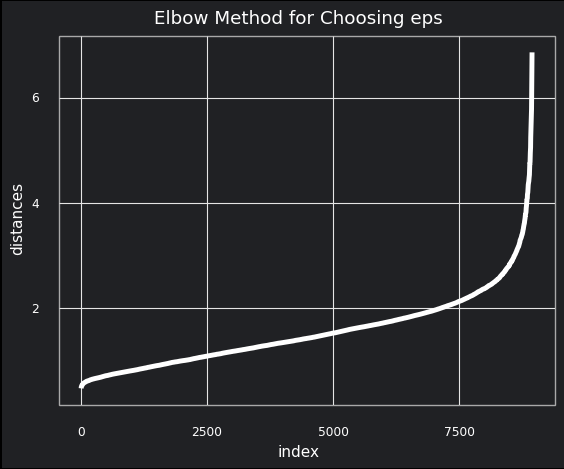

<ggplot: (144873683779)>

In [30]:
# Elbow method

mins = 18
nn = NearestNeighbors(mins + 1)

nn.fit(log_data)

distances, neighbors = nn.kneighbors(log_data)

# sort the distances
distances = np.sort(distances[:, mins], axis = 0)

#plot the distances
distances_df = pd.DataFrame({"distances": distances,
                             "index": list(range(0,len(distances)))})
plt = (ggplot(distances_df, aes(x = "index", y = "distances")) +
 geom_line(color = "white", size = 2) + theme_minimal() +
 labs(title = "Elbow Method for Choosing eps") +
 theme(panel_grid_minor = element_blank(),
      rect = element_rect(fill = "#202124ff"),
      axis_text = element_text(color = "white"),
      axis_title = element_text(color = "white"),
      plot_title = element_text(color = "white"),
      panel_border = element_line(color = "darkgray"),
      plot_background = element_rect(fill = "#202124ff")
      ))


plt

In [31]:
# entry point to min points = # features+1
log_db = DBSCAN(eps =1.8, min_samples = 18).fit(log_data)
pd.DataFrame(log_db.labels_).value_counts()

 1    1897
 0    1679
 3    1645
-1    1043
 2     963
 6     720
 5     593
 4     344
 7      41
 8      25
dtype: int64

In [32]:
# calaculate silhout score without noise 
log_data_copy= log_data.copy()
log_data_copy["DBSCAN labels"] = log_db.labels_

# grab only clustered data points
log_data_copy_clustered = log_data_copy.loc[(log_data_copy["DBSCAN labels"] >= 0)]

silhouette_score(log_data_copy_clustered.drop("DBSCAN labels", axis=1), log_data_copy_clustered["DBSCAN labels"])



0.476312692292802

In [33]:
log_tsne['DBSCAN label']=log_db.labels_
log_tsne['DBSCAN label'].replace(0, "cluster 1", inplace=True)
log_tsne['DBSCAN label'].replace(1, "cluster 2", inplace=True)
log_tsne['DBSCAN label'].replace(2, "cluster 3", inplace=True)
log_tsne['DBSCAN label'].replace(3, "cluster 4", inplace=True)
log_tsne['DBSCAN label'].replace(4, "cluster 5", inplace=True)
log_tsne['DBSCAN label'].replace(5, "cluster 6", inplace=True)
log_tsne['DBSCAN label'].replace(6, "cluster 7", inplace=True)
log_tsne['DBSCAN label'].replace(7, "cluster 8", inplace=True)
log_tsne['DBSCAN label'].replace(8, "cluster 9", inplace=True)
log_tsne['DBSCAN label'].replace(-1, "anomaly", inplace=True)

log_tsne.head()

,0,1,Kmeans label,hier label,DBSCAN label
0,-1.568094,4.714238,cluster 2,cluster 3,cluster 1
1,8.451801,0.446154,cluster 3,cluster 6,cluster 2
2,-0.053930,-11.729030,cluster 7,cluster 1,cluster 3
3,4.041708,0.943736,cluster 5,cluster 1,anomaly
4,-5.146874,-10.742715,cluster 7,cluster 1,cluster 3


In [34]:
fig=px.scatter(x=log_tsne[0], y=log_tsne[1], 
               color=log_tsne['DBSCAN label'],
               color_discrete_sequence=px.colors.qualitative.T10
              )
fig.update_layout( title_text='Log Transform + DBSCAN ,eps =1.8, min_samples = 18  ')
fig.show()

-----------

# 3. Standard Scalar + Log transformed Data

## 3.1 Read Data

In [35]:
stand_log_data=pd.read_csv(STANDARD_LOG_DATA_PATH)
stand_log_data.shape

(8950, 17)

In [36]:
# visualize with TSNE
tsne=TSNE(n_components=2,perplexity=30, verbose=1, n_iter=300 )
stand_log_tsne= tsne.fit_transform(stand_log_data)
stand_log_tsne = pd.DataFrame(stand_log_tsne, index=stand_log_data.index)
stand_log_tsne.shape

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 8950 samples in 0.001s...
[t-SNE] Computed neighbors for 8950 samples in 5.937s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8950
[t-SNE] Computed conditional probabilities for sample 2000 / 8950
[t-SNE] Computed conditional probabilities for sample 3000 / 8950
[t-SNE] Computed conditional probabilities for sample 4000 / 8950
[t-SNE] Computed conditional probabilities for sample 5000 / 8950
[t-SNE] Computed conditional probabilities for sample 6000 / 8950
[t-SNE] Computed conditional probabilities for sample 7000 / 8950
[t-SNE] Computed conditional probabilities for sample 8000 / 8950
[t-SNE] Computed conditional probabilities for sample 8950 / 8950
[t-SNE] Mean sigma: 0.631925
[t-SNE] KL divergence after 250 iterations with early exaggeration: 77.575081
[t-SNE] KL divergence after 300 iterations: 2.571315


(8950, 2)

## 3.2 Kmeans

In [37]:
stand_KMean=KMeans(n_clusters=7, n_init=1,max_iter=100)
stand_KMean.fit(stand_log_data)
pd.DataFrame(stand_KMean.labels_).value_counts()

5    1748
0    1410
1    1408
2    1350
4    1198
3    1018
6     818
dtype: int64

In [38]:
silhouette_score(stand_log_data, stand_KMean.fit_predict(stand_log_data))

0.21322586109858077

In [39]:
stand_log_tsne['kmeans label']=stand_KMean.labels_
stand_log_tsne['kmeans label'].replace(0, "cluster 1", inplace=True)
stand_log_tsne['kmeans label'].replace(1, "cluster 2", inplace=True)
stand_log_tsne['kmeans label'].replace(2, "cluster 3", inplace=True)
stand_log_tsne['kmeans label'].replace(3, "cluster 4", inplace=True)
stand_log_tsne['kmeans label'].replace(4, "cluster 5", inplace=True)
stand_log_tsne['kmeans label'].replace(5, "cluster 6", inplace=True)
stand_log_tsne['kmeans label'].replace(6, "cluster 7", inplace=True)
stand_log_tsne.head()

,0,1,kmeans label
0,-2.847676,-7.001660,cluster 2
1,5.787333,8.751938,cluster 3
2,-3.299632,1.201815,cluster 6
3,-6.329753,6.777761,cluster 2
4,-8.125033,4.323085,cluster 2


In [40]:
fig=px.scatter(x=stand_log_tsne[0], y=stand_log_tsne[1],
               color=stand_log_tsne['kmeans label'] ,
              color_discrete_sequence=px.colors.qualitative.T10)
fig.update_layout( title_text='Standard Scalar + Log transform + Kmeans , number of clusters=7')
fig.show()

### 3.3 AgglomerativeClustering

In [41]:
# plt.figure(figsize=(10, 7))
# plt.title("Counters Dendograms")
# dend = shc.dendrogram(shc.linkage(y=stand_log_data , method='average',metric='cityblock'),orientation='right') #fill y with your dataframe
#                                                                                       #and method with linkage criteria
#                                                                                       #and metric with distance function

In [42]:
hier_cluster = AgglomerativeClustering(n_clusters=7,linkage='average',affinity='manhattan')
silhouette_score(stand_log_data, hier_cluster.fit_predict(stand_log_data))

0.17150628991197425

In [43]:
pd.DataFrame(hier_cluster.labels_).value_counts()

0    5840
2    2886
6     135
1      73
3      10
4       4
5       2
dtype: int64

In [44]:
stand_log_tsne['hier label']=hier_cluster.labels_
stand_log_tsne['hier label'].replace(0, "cluster 1", inplace=True)
stand_log_tsne['hier label'].replace(1, "cluster 2", inplace=True)
stand_log_tsne['hier label'].replace(2, "cluster 3", inplace=True)
stand_log_tsne['hier label'].replace(3, "cluster 4", inplace=True)
stand_log_tsne['hier label'].replace(4, "cluster 5", inplace=True)
stand_log_tsne['hier label'].replace(5, "cluster 6", inplace=True)
stand_log_tsne['hier label'].replace(6, "cluster 7", inplace=True)
stand_log_tsne.head()

,0,1,kmeans label,hier label
0,-2.847676,-7.001660,cluster 2,cluster 1
1,5.787333,8.751938,cluster 3,cluster 3
2,-3.299632,1.201815,cluster 6,cluster 1
3,-6.329753,6.777761,cluster 2,cluster 2
4,-8.125033,4.323085,cluster 2,cluster 1


In [45]:
fig=px.scatter(x=stand_log_tsne[0], y=stand_log_tsne[1],
               color=stand_log_tsne['hier label'],
               color_discrete_sequence=px.colors.qualitative.T10
              )
fig.update_layout( title_text='Standard Scalar + Log Transform + AgglomerativeClustering , number of clusters=7 ')
fig.show()

### 3.4 DBSCAN

C:\Users\esraa\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning:

Pass n_neighbors=19 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error



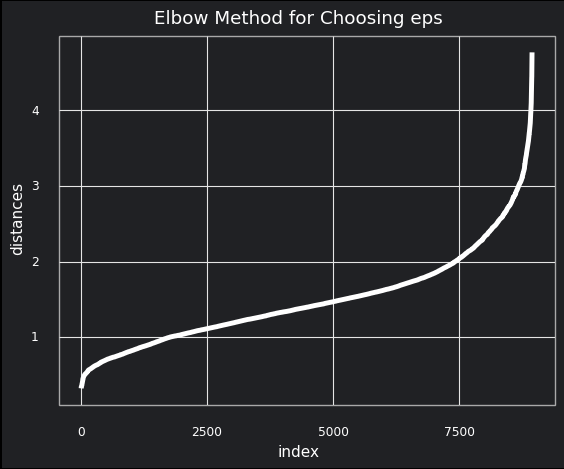

<ggplot: (144873973767)>

In [46]:
# Elbow method

mins = 18
nn = NearestNeighbors(mins + 1)

nn.fit(stand_log_data)

distances, neighbors = nn.kneighbors(stand_log_data)

# sort the distances
distances = np.sort(distances[:, mins], axis = 0)

#plot the distances
distances_df = pd.DataFrame({"distances": distances,
                             "index": list(range(0,len(distances)))})
plt = (ggplot(distances_df, aes(x = "index", y = "distances")) +
 geom_line(color = "white", size = 2) + theme_minimal() +
 labs(title = "Elbow Method for Choosing eps") +
 theme(panel_grid_minor = element_blank(),
      rect = element_rect(fill = "#202124ff"),
      axis_text = element_text(color = "white"),
      axis_title = element_text(color = "white"),
      plot_title = element_text(color = "white"),
      panel_border = element_line(color = "darkgray"),
      plot_background = element_rect(fill = "#202124ff")
      ))


plt

In [47]:
# entry point to min points = # features+1
stand_log_db = DBSCAN(eps =1.3, min_samples = 18).fit(stand_log_data)
pd.DataFrame(stand_log_db.labels_).value_counts()

 1    3700
-1    3212
 0    1572
 3     140
 2     133
 5      74
 4      61
 6      24
 7      21
 8      13
dtype: int64

In [48]:
# calaculate silhout score without noise 
stand_log_data_copy= stand_log_data.copy()
stand_log_data_copy["DBSCAN labels"] = stand_log_db.labels_

# grab only clustered data points
stand_log_data_copy_clustered = stand_log_data_copy.loc[(stand_log_data_copy["DBSCAN labels"] >= 0)]

silhouette_score(stand_log_data_copy_clustered.drop("DBSCAN labels", axis=1), stand_log_data_copy_clustered["DBSCAN labels"])



0.048489438998130754

In [49]:
stand_log_tsne['DBSCAN label']=stand_log_db.labels_
stand_log_tsne['DBSCAN label'].replace(0, "cluster 1", inplace=True)
stand_log_tsne['DBSCAN label'].replace(1, "cluster 2", inplace=True)
stand_log_tsne['DBSCAN label'].replace(2, "cluster 3", inplace=True)
stand_log_tsne['DBSCAN label'].replace(3, "cluster 4", inplace=True)
stand_log_tsne['DBSCAN label'].replace(4, "cluster 5", inplace=True)
stand_log_tsne['DBSCAN label'].replace(5, "cluster 6", inplace=True)
stand_log_tsne['DBSCAN label'].replace(6, "cluster 7", inplace=True)
stand_log_tsne['DBSCAN label'].replace(7, "cluster 8", inplace=True)
stand_log_tsne['DBSCAN label'].replace(8, "cluster 9", inplace=True)
stand_log_tsne['DBSCAN label'].replace(-1, "anomaly", inplace=True)

stand_log_tsne.head()

,0,1,kmeans label,hier label,DBSCAN label
0,-2.847676,-7.001660,cluster 2,cluster 1,cluster 2
1,5.787333,8.751938,cluster 3,cluster 3,cluster 1
2,-3.299632,1.201815,cluster 6,cluster 1,cluster 2
3,-6.329753,6.777761,cluster 2,cluster 2,anomaly
4,-8.125033,4.323085,cluster 2,cluster 1,cluster 2


In [50]:
fig=px.scatter(x=stand_log_tsne[0], y=stand_log_tsne[1], 
               color=stand_log_tsne['DBSCAN label'],
               color_discrete_sequence=px.colors.qualitative.T10
              )
fig.update_layout( title_text='Log Transform + DBSCAN ,eps =1.3, min_samples = 18')
fig.show()

------------

# 4. MinMax Scaled + Log Transformed Data 

###  4.1 Read Data

In [51]:
minmax_log_data = pd.read_csv(MINMAXSCALAR_LOG_DATA_PATH)
minmax_log_data.shape

(8950, 17)

In [52]:
# visualize with TSNE
tsne=TSNE(n_components=2,perplexity=30, verbose=1, n_iter=300 )
minmax_log_tsne= tsne.fit_transform(minmax_log_data)
minmax_log_tsne = pd.DataFrame(minmax_log_tsne, index=minmax_log_data.index)
minmax_log_tsne.shape

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 8950 samples in 0.003s...
[t-SNE] Computed neighbors for 8950 samples in 9.600s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8950
[t-SNE] Computed conditional probabilities for sample 2000 / 8950
[t-SNE] Computed conditional probabilities for sample 3000 / 8950
[t-SNE] Computed conditional probabilities for sample 4000 / 8950
[t-SNE] Computed conditional probabilities for sample 5000 / 8950
[t-SNE] Computed conditional probabilities for sample 6000 / 8950
[t-SNE] Computed conditional probabilities for sample 7000 / 8950
[t-SNE] Computed conditional probabilities for sample 8000 / 8950
[t-SNE] Computed conditional probabilities for sample 8950 / 8950
[t-SNE] Mean sigma: 0.125618
[t-SNE] KL divergence after 250 iterations with early exaggeration: 73.024567
[t-SNE] KL divergence after 300 iterations: 2.429621


(8950, 2)

### 4.2 Kmeans

In [53]:
KMean=KMeans(n_clusters=7, n_init=1,max_iter=100)
KMean.fit(minmax_log_data)
pd.DataFrame(KMean.labels_).value_counts()

1    2527
2    1241
4    1190
0    1154
5    1097
6     912
3     829
dtype: int64

In [54]:
silhouette_score(minmax_log_data, KMean.fit_predict(minmax_log_data))

0.2714574305705541

In [55]:
minmax_log_tsne['kmeans label']=KMean.labels_
minmax_log_tsne['kmeans label'].replace(0, "cluster 1", inplace=True)
minmax_log_tsne['kmeans label'].replace(1, "cluster 2", inplace=True)
minmax_log_tsne['kmeans label'].replace(2, "cluster 3", inplace=True)
minmax_log_tsne['kmeans label'].replace(3, "cluster 4", inplace=True)
minmax_log_tsne['kmeans label'].replace(4, "cluster 5", inplace=True)
minmax_log_tsne['kmeans label'].replace(5, "cluster 6", inplace=True)
minmax_log_tsne['kmeans label'].replace(6, "cluster 7", inplace=True)
minmax_log_tsne.head()

,0,1,kmeans label
0,8.394225,2.080111,cluster 6
1,-2.716138,8.539643,cluster 2
2,4.958570,-10.352337,cluster 5
3,8.712743,-0.790762,cluster 3
4,0.938160,-3.282809,cluster 3


In [56]:
fig=px.scatter(x=minmax_log_tsne[0], y=minmax_log_tsne[1], 
               color=minmax_log_tsne['kmeans label'],
              color_discrete_sequence=px.colors.qualitative.T10)
fig.update_layout( title_text='MinMax Scalar + Log transform + Kmeans , number of clusters=7')
fig.show()

### 4.3 AgglomerativeClustering

In [57]:
# plt.figure(figsize=(10, 7))
# plt.title("Counters Dendograms")
# dend = shc.dendrogram(shc.linkage(y=minmax_log_data , method='average',metric='cityblock'),orientation='right') #fill y with your dataframe
#                                                                                       #and method with linkage criteria
#                                                                                       #and metric with distance function

In [58]:
hier_cluster = AgglomerativeClustering(n_clusters=7,linkage='average',affinity='manhattan')
silhouette_score(minmax_log_data, hier_cluster.fit_predict(minmax_log_data))

0.21844639802636892

In [59]:
pd.DataFrame(hier_cluster.labels_).value_counts()

1    3558
0    2659
4    1431
2    1087
3     204
5      10
6       1
dtype: int64

In [60]:
minmax_log_tsne['hier label']=hier_cluster.labels_
minmax_log_tsne['hier label'].replace(0, "cluster 1", inplace=True)
minmax_log_tsne['hier label'].replace(1, "cluster 2", inplace=True)
minmax_log_tsne['hier label'].replace(2, "cluster 3", inplace=True)
minmax_log_tsne['hier label'].replace(3, "cluster 4", inplace=True)
minmax_log_tsne['hier label'].replace(4, "cluster 5", inplace=True)
minmax_log_tsne['hier label'].replace(5, "cluster 6", inplace=True)
minmax_log_tsne['hier label'].replace(6, "cluster 7", inplace=True)
minmax_log_tsne.head()

,0,1,kmeans label,hier label
0,8.394225,2.080111,cluster 6,cluster 2
1,-2.716138,8.539643,cluster 2,cluster 1
2,4.958570,-10.352337,cluster 5,cluster 3
3,8.712743,-0.790762,cluster 3,cluster 1
4,0.938160,-3.282809,cluster 3,cluster 3


In [61]:
fig=px.scatter(x=minmax_log_tsne[0], y=minmax_log_tsne[1],
               color=minmax_log_tsne['hier label'],
               color_discrete_sequence=px.colors.qualitative.T10
              )
fig.update_layout( title_text='MinMax Scalar + Log transform  + AgglomerativeClustering , number of clusters=7 ')
fig.show()

### 4.4 DBSCAN

C:\Users\esraa\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning:

Pass n_neighbors=19 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error



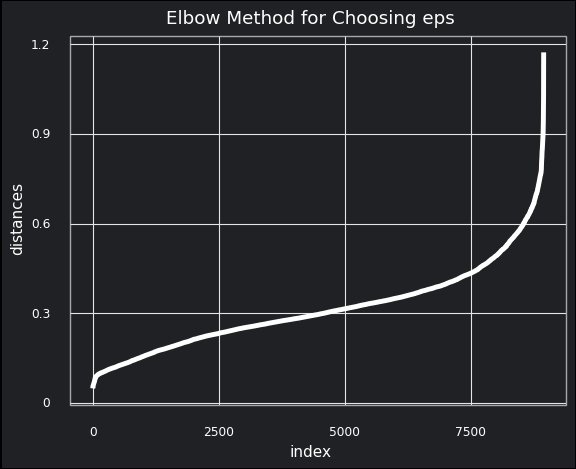

<ggplot: (144874085440)>

In [62]:
# Elbow method

mins = 18
nn = NearestNeighbors(mins + 1)

nn.fit(minmax_log_data)

distances, neighbors = nn.kneighbors(minmax_log_data)

# sort the distances
distances = np.sort(distances[:, mins], axis = 0)

#plot the distances
distances_df = pd.DataFrame({"distances": distances,
                             "index": list(range(0,len(distances)))})
plt = (ggplot(distances_df, aes(x = "index", y = "distances")) +
 geom_line(color = "white", size = 2) + theme_minimal() +
 labs(title = "Elbow Method for Choosing eps") +
 theme(panel_grid_minor = element_blank(),
      rect = element_rect(fill = "#202124ff"),
      axis_text = element_text(color = "white"),
      axis_title = element_text(color = "white"),
      plot_title = element_text(color = "white"),
      panel_border = element_line(color = "darkgray"),
      plot_background = element_rect(fill = "#202124ff")
      ))


plt

In [63]:
# entry point to min points = # features+1
minmax_log_db = DBSCAN(eps =0.32, min_samples = 18).fit(minmax_log_data)
pd.DataFrame(minmax_log_db.labels_).value_counts()

 1    3841
-1    1966
 0    1841
 2     544
 4     461
 3     271
 5      26
dtype: int64

In [64]:
# calaculate silhout score without noise 
minmax_log_data_copy= minmax_log_data.copy()
minmax_log_data_copy["DBSCAN labels"] = minmax_log_db.labels_

# grab only clustered data points
minmax_log_data_copy_clustered = minmax_log_data_copy.loc[(minmax_log_data_copy["DBSCAN labels"] >= 0)]

silhouette_score(minmax_log_data_copy_clustered.drop("DBSCAN labels", axis=1), minmax_log_data_copy_clustered["DBSCAN labels"])



0.1516746831668743

In [65]:
minmax_log_tsne['DBSCAN label']=minmax_log_db.labels_
minmax_log_tsne['DBSCAN label'].replace(0, "cluster 1", inplace=True)
minmax_log_tsne['DBSCAN label'].replace(1, "cluster 2", inplace=True)
minmax_log_tsne['DBSCAN label'].replace(2, "cluster 3", inplace=True)
minmax_log_tsne['DBSCAN label'].replace(3, "cluster 4", inplace=True)
minmax_log_tsne['DBSCAN label'].replace(4, "cluster 5", inplace=True)
minmax_log_tsne['DBSCAN label'].replace(5, "cluster 6", inplace=True)
minmax_log_tsne['DBSCAN label'].replace(-1, "anomaly", inplace=True)

minmax_log_tsne.head()

,0,1,kmeans label,hier label,DBSCAN label
0,8.394225,2.080111,cluster 6,cluster 2,cluster 2
1,-2.716138,8.539643,cluster 2,cluster 1,cluster 1
2,4.958570,-10.352337,cluster 5,cluster 3,cluster 2
3,8.712743,-0.790762,cluster 3,cluster 1,anomaly
4,0.938160,-3.282809,cluster 3,cluster 3,cluster 2


In [66]:
fig=px.scatter(x=minmax_log_tsne[0], y=minmax_log_tsne[1], 
               color=minmax_log_tsne['DBSCAN label'],
               color_discrete_sequence=px.colors.qualitative.T10
              )
fig.update_layout( title_text='MinMax Scalar + Log transform + DBSCAN ,eps =0.32, min_samples = 18 ')
fig.show()

----------------


# 5. MinMax Scaled + Log Transformed + PCA Data 

### 5.1 Read Data

In [67]:
pca_data= pd.read_csv(DATA_PCA)
pca_data.shape

(8950, 8)

In [68]:
# visualize with TSNE
tsne=TSNE(n_components=2,perplexity=30, verbose=1, n_iter=300 )
minmax_pca_tsne= tsne.fit_transform(pca_data)
minmax_pca_tsne = pd.DataFrame(minmax_pca_tsne, index=pca_data.index)
minmax_pca_tsne.shape

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 8950 samples in 0.064s...
[t-SNE] Computed neighbors for 8950 samples in 1.264s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8950
[t-SNE] Computed conditional probabilities for sample 2000 / 8950
[t-SNE] Computed conditional probabilities for sample 3000 / 8950
[t-SNE] Computed conditional probabilities for sample 4000 / 8950
[t-SNE] Computed conditional probabilities for sample 5000 / 8950
[t-SNE] Computed conditional probabilities for sample 6000 / 8950
[t-SNE] Computed conditional probabilities for sample 7000 / 8950
[t-SNE] Computed conditional probabilities for sample 8000 / 8950
[t-SNE] Computed conditional probabilities for sample 8950 / 8950
[t-SNE] Mean sigma: 0.079619
[t-SNE] KL divergence after 250 iterations with early exaggeration: 71.865082
[t-SNE] KL divergence after 300 iterations: 2.351296


(8950, 2)

### 5.2 Kmeans

In [69]:
KMean=KMeans(n_clusters=7, n_init=1,max_iter=100)
KMean.fit(pca_data)
pd.DataFrame(KMean.labels_).value_counts()

2    2084
1    1765
0    1257
3    1234
4    1054
6     887
5     669
dtype: int64

In [70]:
silhouette_score(pca_data, KMean.fit_predict(pca_data))

0.2987156769431671

In [71]:
minmax_pca_tsne['kmeans label']=KMean.labels_
minmax_pca_tsne['kmeans label'].replace(0, "cluster 1", inplace=True)
minmax_pca_tsne['kmeans label'].replace(1, "cluster 2", inplace=True)
minmax_pca_tsne['kmeans label'].replace(2, "cluster 3", inplace=True)
minmax_pca_tsne['kmeans label'].replace(3, "cluster 4", inplace=True)
minmax_pca_tsne['kmeans label'].replace(4, "cluster 5", inplace=True)
minmax_pca_tsne['kmeans label'].replace(5, "cluster 6", inplace=True)
minmax_pca_tsne['kmeans label'].replace(6, "cluster 7", inplace=True)
minmax_pca_tsne.head()

,0,1,kmeans label
0,9.570947,4.840507,cluster 4
1,-7.732289,3.256955,cluster 2
2,9.005344,-7.873956,cluster 6
3,-0.886090,0.993443,cluster 7
4,14.239258,-1.028893,cluster 4


In [72]:
fig=px.scatter(x=minmax_pca_tsne[0], y=minmax_pca_tsne[1],
               color=minmax_pca_tsne['kmeans label'],
              color_discrete_sequence=px.colors.qualitative.T10)
fig.update_layout( title_text=' MinMax Scalar +Log Transform+ PCA + Kmeans , number of clusters=7 ')
fig.show()

### 5.3 AgglomerativeClustering

In [73]:
# plt.figure(figsize=(10, 7))
# plt.title("Counters Dendograms")
# dend = shc.dendrogram(shc.linkage(y=pca_data , method='average',metric='cityblock'),orientation='right') #fill y with your dataframe
#                                                                                       #and method with linkage criteria
#                                                                                       #and metric with distance function

In [74]:
hier_cluster = AgglomerativeClustering(n_clusters=7,linkage='average',affinity='manhattan')
silhouette_score(pca_data, hier_cluster.fit_predict(pca_data))

0.21477291454159958

In [75]:
pd.DataFrame(hier_cluster.labels_).value_counts()

1    4395
2    2908
3     991
4     631
0      12
5       9
6       4
dtype: int64

In [76]:
minmax_pca_tsne['hier label']=hier_cluster.labels_
minmax_pca_tsne['hier label'].replace(0, "cluster 1", inplace=True)
minmax_pca_tsne['hier label'].replace(1, "cluster 2", inplace=True)
minmax_pca_tsne['hier label'].replace(2, "cluster 3", inplace=True)
minmax_pca_tsne['hier label'].replace(3, "cluster 4", inplace=True)
minmax_pca_tsne['hier label'].replace(4, "cluster 5", inplace=True)
minmax_pca_tsne['hier label'].replace(5, "cluster 6", inplace=True)
minmax_pca_tsne['hier label'].replace(6, "cluster 7", inplace=True)
minmax_pca_tsne.head()

,0,1,kmeans label,hier label
0,9.570947,4.840507,cluster 4,cluster 2
1,-7.732289,3.256955,cluster 2,cluster 3
2,9.005344,-7.873956,cluster 6,cluster 5
3,-0.886090,0.993443,cluster 7,cluster 3
4,14.239258,-1.028893,cluster 4,cluster 4


In [77]:
fig=px.scatter(x=minmax_pca_tsne[0], y=minmax_pca_tsne[1],
               color=minmax_pca_tsne['hier label'],
               color_discrete_sequence=px.colors.qualitative.T10
              )
fig.update_layout( title_text='MinMax Scalar +Log Transform+ PCA  + AgglomerativeClustering , number of clusters=7 ')
fig.show()

### 5.4 DBSCAN

C:\Users\esraa\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning:

Pass n_neighbors=10 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error



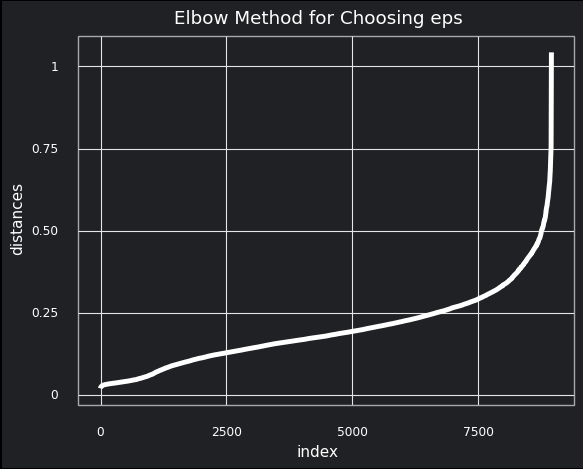

<ggplot: (144874681194)>

In [78]:
# Elbow method

mins = 9
nn = NearestNeighbors(mins + 1)

nn.fit(pca_data)

distances, neighbors = nn.kneighbors(pca_data)

# sort the distances
distances = np.sort(distances[:, mins], axis = 0)

#plot the distances
distances_df = pd.DataFrame({"distances": distances,
                             "index": list(range(0,len(distances)))})
plt = (ggplot(distances_df, aes(x = "index", y = "distances")) +
 geom_line(color = "white", size = 2) + theme_minimal() +
 labs(title = "Elbow Method for Choosing eps") +
 theme(panel_grid_minor = element_blank(),
      rect = element_rect(fill = "#202124ff"),
      axis_text = element_text(color = "white"),
      axis_title = element_text(color = "white"),
      plot_title = element_text(color = "white"),
      panel_border = element_line(color = "darkgray"),
      plot_background = element_rect(fill = "#202124ff")
      ))


plt

In [79]:
# entry point to min points = # features+1
pca_db = DBSCAN(eps =0.28, min_samples = 9).fit(pca_data)
pd.DataFrame(pca_db.labels_).value_counts()

 0    4323
 1    3778
-1     800
 2      29
 4      11
 3       9
dtype: int64

In [80]:
# calaculate silhout score without noise 
pca_data_copy= pca_data.copy()
pca_data_copy["DBSCAN labels"] = pca_db.labels_

# grab only clustered data points
pca_data_copy_clustered = pca_data_copy.loc[(pca_data_copy["DBSCAN labels"] >= 0)]

silhouette_score(pca_data_copy_clustered.drop("DBSCAN labels", axis=1), pca_data_copy_clustered["DBSCAN labels"])



0.056406413052862224

In [81]:
minmax_pca_tsne['DBSCAN label']=pca_db.labels_
minmax_pca_tsne['DBSCAN label'].replace(0, "cluster 1", inplace=True)
minmax_pca_tsne['DBSCAN label'].replace(1, "cluster 2", inplace=True)
minmax_pca_tsne['DBSCAN label'].replace(2, "cluster 3", inplace=True)
minmax_pca_tsne['DBSCAN label'].replace(3, "cluster 4", inplace=True)
minmax_pca_tsne['DBSCAN label'].replace(4, "cluster 5", inplace=True)
minmax_pca_tsne['DBSCAN label'].replace(-1, "anomaly", inplace=True)

minmax_pca_tsne.head()

,0,1,kmeans label,hier label,DBSCAN label
0,9.570947,4.840507,cluster 4,cluster 2,cluster 1
1,-7.732289,3.256955,cluster 2,cluster 3,cluster 2
2,9.005344,-7.873956,cluster 6,cluster 5,cluster 1
3,-0.886090,0.993443,cluster 7,cluster 3,cluster 2
4,14.239258,-1.028893,cluster 4,cluster 4,cluster 1


In [82]:
fig=px.scatter(x=minmax_pca_tsne[0], y=minmax_pca_tsne[1], 
               color=minmax_pca_tsne['DBSCAN label'],
               color_discrete_sequence=px.colors.qualitative.T10
              )
fig.update_layout( title_text='MinMax Scalar +Log Transform+ PCA + DBSCAN ,eps =0.28, min_samples = 9 ')
fig.show()

----------------------

# 6. MinMAx Scalar + Log Transform + Kernel PCA Data

### 6.1 Read Data

In [83]:
kpca_data= pd.read_csv(DATA_KERNEL_PCA)
kpca_data.shape

(8950, 8)

In [84]:
# visualize with TSNE
tsne=TSNE(n_components=2,perplexity=30, verbose=1, n_iter=300 )
kpca_tsne= tsne.fit_transform(kpca_data)
kpca_tsne = pd.DataFrame(kpca_tsne, index=kpca_data.index)
kpca_tsne.shape

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 8950 samples in 0.052s...
[t-SNE] Computed neighbors for 8950 samples in 1.152s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8950
[t-SNE] Computed conditional probabilities for sample 2000 / 8950
[t-SNE] Computed conditional probabilities for sample 3000 / 8950
[t-SNE] Computed conditional probabilities for sample 4000 / 8950
[t-SNE] Computed conditional probabilities for sample 5000 / 8950
[t-SNE] Computed conditional probabilities for sample 6000 / 8950
[t-SNE] Computed conditional probabilities for sample 7000 / 8950
[t-SNE] Computed conditional probabilities for sample 8000 / 8950
[t-SNE] Computed conditional probabilities for sample 8950 / 8950
[t-SNE] Mean sigma: 0.014715
[t-SNE] KL divergence after 250 iterations with early exaggeration: 71.678391
[t-SNE] KL divergence after 300 iterations: 2.343563


(8950, 2)

### 6.2 Apply Kmeans

In [85]:
KMean=KMeans(n_clusters=7, n_init=1,max_iter=100)
KMean.fit(kpca_data)
pd.DataFrame(KMean.labels_).value_counts()

0    2486
4    1259
2    1156
5    1148
3    1076
6     981
1     844
dtype: int64

In [86]:
silhouette_score(kpca_data, KMean.fit_predict(kpca_data))

0.3117862644956518

In [87]:
kpca_tsne['kmeans label']=KMean.labels_
kpca_tsne['kmeans label'].replace(0, "cluster 1", inplace=True)
kpca_tsne['kmeans label'].replace(1, "cluster 2", inplace=True)
kpca_tsne['kmeans label'].replace(2, "cluster 3", inplace=True)
kpca_tsne['kmeans label'].replace(3, "cluster 4", inplace=True)
kpca_tsne['kmeans label'].replace(4, "cluster 5", inplace=True)
kpca_tsne['kmeans label'].replace(5, "cluster 6", inplace=True)
kpca_tsne['kmeans label'].replace(6, "cluster 7", inplace=True)
kpca_tsne.head()

,0,1,kmeans label
0,-10.103964,7.114615,cluster 6
1,6.933115,-1.150179,cluster 4
2,-5.063025,-1.509627,cluster 5
3,-8.070620,-7.552147,cluster 1
4,-13.309633,-1.960500,cluster 6


In [88]:
fig=px.scatter(x=kpca_tsne[0], y=kpca_tsne[1], 
               color=kpca_tsne['kmeans label'],
              color_discrete_sequence=px.colors.qualitative.T10)
fig.update_layout( title_text=' MinMax Scalar +Log Transform+ Kernel PCA + Kmeans , number of clusters=7 ')
fig.show()

### 6.3 AgglomerativeClustering

In [89]:
# plt.figure(figsize=(10, 7))
# plt.title("Counters Dendograms")
# dend = shc.dendrogram(shc.linkage(y=kpca_data , method='average',metric='cityblock'),orientation='right') #fill y with your dataframe
#                                                                                       #and method with linkage criteria
#                                                                                       #and metric with distance function

In [90]:
hier_cluster = AgglomerativeClustering(n_clusters=7,linkage='average',affinity='manhattan')
silhouette_score(kpca_data, hier_cluster.fit_predict(kpca_data))

0.24596573417691378

In [91]:
pd.DataFrame(hier_cluster.labels_).value_counts()

4    2860
2    2783
0    1674
6    1368
1     254
3       7
5       4
dtype: int64

In [92]:
kpca_tsne['hier label']=hier_cluster.labels_
kpca_tsne['hier label'].replace(0, "cluster 1", inplace=True)
kpca_tsne['hier label'].replace(1, "cluster 2", inplace=True)
kpca_tsne['hier label'].replace(2, "cluster 3", inplace=True)
kpca_tsne['hier label'].replace(3, "cluster 4", inplace=True)
kpca_tsne['hier label'].replace(4, "cluster 5", inplace=True)
kpca_tsne['hier label'].replace(5, "cluster 6", inplace=True)
kpca_tsne['hier label'].replace(6, "cluster 7", inplace=True)
kpca_tsne.head()

,0,1,kmeans label,hier label
0,-10.103964,7.114615,cluster 6,cluster 1
1,6.933115,-1.150179,cluster 4,cluster 5
2,-5.063025,-1.509627,cluster 5,cluster 2
3,-8.070620,-7.552147,cluster 1,cluster 5
4,-13.309633,-1.960500,cluster 6,cluster 1


In [93]:
fig=px.scatter(x=kpca_tsne[0], y=kpca_tsne[1], 
               color=kpca_tsne['hier label'],
               color_discrete_sequence=px.colors.qualitative.T10
              )
fig.update_layout( title_text='MinMax Scalar +Log Transform+ Kernel PCA + AgglomerativeClustering , number of clusters=7 ')
fig.show()

### 6.4 DBSCAN

C:\Users\esraa\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning:

Pass n_neighbors=10 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error



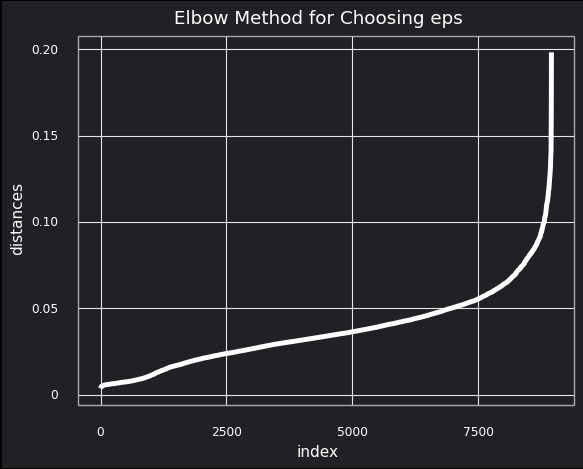

<ggplot: (144874687781)>

In [94]:
# Elbow method

mins = 9
nn = NearestNeighbors(mins + 1)

nn.fit(kpca_data)

distances, neighbors = nn.kneighbors(kpca_data)

# sort the distances
distances = np.sort(distances[:, mins], axis = 0)

#plot the distances
distances_df = pd.DataFrame({"distances": distances,
                             "index": list(range(0,len(distances)))})
plt = (ggplot(distances_df, aes(x = "index", y = "distances")) +
 geom_line(color = "white", size = 2) + theme_minimal() +
 labs(title = "Elbow Method for Choosing eps") +
 theme(panel_grid_minor = element_blank(),
      rect = element_rect(fill = "#202124ff"),
      axis_text = element_text(color = "white"),
      axis_title = element_text(color = "white"),
      plot_title = element_text(color = "white"),
      panel_border = element_line(color = "darkgray"),
      plot_background = element_rect(fill = "#202124ff")
      ))


plt

In [95]:
# entry point to min points = # features+1
kpca_db = DBSCAN(eps =0.05, min_samples = 9).fit(kpca_data)
pd.DataFrame(kpca_db.labels_).value_counts()

 0    4177
 1    2583
 2    1108
-1    1019
 3      24
 5      18
 4      12
 6       9
dtype: int64

In [96]:
# calaculate silhout score without noise 
kpca_data_copy= kpca_data.copy()
kpca_data_copy["DBSCAN labels"] = kpca_db.labels_

# grab only clustered data points
kpca_data_copy_clustered = kpca_data_copy.loc[(kpca_data_copy["DBSCAN labels"] >= 0)]

silhouette_score(kpca_data_copy_clustered.drop("DBSCAN labels", axis=1), kpca_data_copy_clustered["DBSCAN labels"])



0.1271670181314703

In [97]:
kpca_tsne['DBSCAN label']=kpca_db.labels_
kpca_tsne['DBSCAN label'].replace(0, "cluster 1", inplace=True)
kpca_tsne['DBSCAN label'].replace(1, "cluster 2", inplace=True)
kpca_tsne['DBSCAN label'].replace(2, "cluster 3", inplace=True)
kpca_tsne['DBSCAN label'].replace(3, "cluster 4", inplace=True)
kpca_tsne['DBSCAN label'].replace(4, "cluster 5", inplace=True)
kpca_tsne['DBSCAN label'].replace(5, "cluster 6", inplace=True)
kpca_tsne['DBSCAN label'].replace(6, "cluster 7", inplace=True)
kpca_tsne['DBSCAN label'].replace(-1, "anomaly", inplace=True)

kpca_tsne.head()

,0,1,kmeans label,hier label,DBSCAN label
0,-10.103964,7.114615,cluster 6,cluster 1,cluster 1
1,6.933115,-1.150179,cluster 4,cluster 5,cluster 2
2,-5.063025,-1.509627,cluster 5,cluster 2,cluster 1
3,-8.070620,-7.552147,cluster 1,cluster 5,cluster 2
4,-13.309633,-1.960500,cluster 6,cluster 1,cluster 1


In [98]:
fig=px.scatter(x=kpca_tsne[0], y=kpca_tsne[1], 
               color=kpca_tsne['DBSCAN label'],
               color_discrete_sequence=px.colors.qualitative.T10
              )
fig.update_layout( title_text='MinMax Scalar +Log Transform+ Kernel PCA + DBSCAN ,eps =0.05, min_samples = 9 ')
fig.show()

-----------------------

# 7. Log Transformed data + PCA

### 7.1 Read Data

In [99]:
log_pca_data= pd.read_csv(LOG_DATA_PCA)
log_pca_data.shape

(8950, 8)

In [100]:
# visualize with TSNE
tsne=TSNE(n_components=2,perplexity=30, verbose=1, n_iter=300 )
log_pca_tsne= tsne.fit_transform(log_pca_data)
log_pca_tsne = pd.DataFrame(log_pca_tsne, index=log_pca_data.index)
log_pca_tsne.shape

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 8950 samples in 0.140s...
[t-SNE] Computed neighbors for 8950 samples in 1.568s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8950
[t-SNE] Computed conditional probabilities for sample 2000 / 8950
[t-SNE] Computed conditional probabilities for sample 3000 / 8950
[t-SNE] Computed conditional probabilities for sample 4000 / 8950
[t-SNE] Computed conditional probabilities for sample 5000 / 8950
[t-SNE] Computed conditional probabilities for sample 6000 / 8950
[t-SNE] Computed conditional probabilities for sample 7000 / 8950
[t-SNE] Computed conditional probabilities for sample 8000 / 8950
[t-SNE] Computed conditional probabilities for sample 8950 / 8950
[t-SNE] Mean sigma: 0.570329
[t-SNE] KL divergence after 250 iterations with early exaggeration: 71.004051
[t-SNE] KL divergence after 300 iterations: 2.375290


(8950, 2)

### 7.2 Kmeans

In [101]:
KMean=KMeans(n_clusters=7, n_init=1,max_iter=100)
KMean.fit(log_pca_data)
pd.DataFrame(KMean.labels_).value_counts()

1    2091
0    1867
3    1351
5    1097
2     887
6     878
4     779
dtype: int64

In [102]:
silhouette_score(log_pca_data, KMean.fit_predict(log_pca_data))

0.38346523638303215

In [103]:
log_pca_tsne['kmeans label']=KMean.labels_
log_pca_tsne['kmeans label'].replace(0, "cluster 1", inplace=True)
log_pca_tsne['kmeans label'].replace(1, "cluster 2", inplace=True)
log_pca_tsne['kmeans label'].replace(2, "cluster 3", inplace=True)
log_pca_tsne['kmeans label'].replace(3, "cluster 4", inplace=True)
log_pca_tsne['kmeans label'].replace(4, "cluster 5", inplace=True)
log_pca_tsne['kmeans label'].replace(5, "cluster 6", inplace=True)
log_pca_tsne['kmeans label'].replace(6, "cluster 7", inplace=True)
log_pca_tsne.head()

,0,1,kmeans label
0,-5.852539,-0.321542,cluster 3
1,11.291631,-3.098779,cluster 2
2,-8.044967,-8.990279,cluster 7
3,-0.987772,8.678826,cluster 5
4,-3.945406,-7.350268,cluster 7


In [104]:
fig=px.scatter(x=log_pca_tsne[0], y=log_pca_tsne[1],
               color=log_pca_tsne['kmeans label'],
              color_discrete_sequence=px.colors.qualitative.T10)
fig.update_layout( title_text='Log Transform+ PCA + Kmeans , number of clusters=7 ')
fig.show()

### 7.3 AgglomerativeClustering

In [105]:
# plt.figure(figsize=(10, 7))
# plt.title("Counters Dendograms")
# dend = shc.dendrogram(shc.linkage(y=log_pca_data , method='average',metric='cityblock'),orientation='right') #fill y with your dataframe
#                                                                                       #and method with linkage criteria
#                                                                                       #and metric with distance function

In [106]:
hier_cluster = AgglomerativeClustering(n_clusters=7,linkage='average',affinity='manhattan')
silhouette_score(log_pca_data, hier_cluster.fit_predict(log_pca_data))

0.2547636977481461

In [107]:
pd.DataFrame(hier_cluster.labels_).value_counts()

1    4554
2    2222
3    2053
0      67
5      37
4      16
6       1
dtype: int64

In [108]:
log_pca_tsne['hier label']=KMean.labels_
log_pca_tsne['hier label'].replace(0, "cluster 1", inplace=True)
log_pca_tsne['hier label'].replace(1, "cluster 2", inplace=True)
log_pca_tsne['hier label'].replace(2, "cluster 3", inplace=True)
log_pca_tsne['hier label'].replace(3, "cluster 4", inplace=True)
log_pca_tsne['hier label'].replace(4, "cluster 5", inplace=True)
log_pca_tsne['hier label'].replace(5, "cluster 6", inplace=True)
log_pca_tsne['hier label'].replace(6, "cluster 7", inplace=True)
log_pca_tsne.head()

,0,1,kmeans label,hier label
0,-5.852539,-0.321542,cluster 3,cluster 3
1,11.291631,-3.098779,cluster 2,cluster 2
2,-8.044967,-8.990279,cluster 7,cluster 7
3,-0.987772,8.678826,cluster 5,cluster 5
4,-3.945406,-7.350268,cluster 7,cluster 7


In [109]:
fig=px.scatter(x=log_pca_tsne[0], y=log_pca_tsne[1], 
               color=log_pca_tsne['hier label'],
               color_discrete_sequence=px.colors.qualitative.T10
              )
fig.update_layout( title_text=' Log Transform+ PCA + AgglomerativeClustering , number of clusters=7 ')
fig.show()

### 7.4 DBSCAN

C:\Users\esraa\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning:

Pass n_neighbors=10 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error



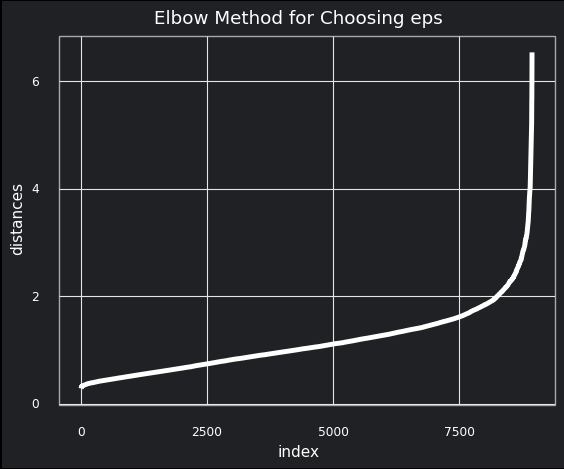

<ggplot: (144873910917)>

In [110]:
# Elbow method

mins = 9
nn = NearestNeighbors(mins + 1)

nn.fit(log_pca_data)

distances, neighbors = nn.kneighbors(log_pca_data)

# sort the distances
distances = np.sort(distances[:, mins], axis = 0)

#plot the distances
distances_df = pd.DataFrame({"distances": distances,
                             "index": list(range(0,len(distances)))})
plt = (ggplot(distances_df, aes(x = "index", y = "distances")) +
 geom_line(color = "white", size = 2) + theme_minimal() +
 labs(title = "Elbow Method for Choosing eps") +
 theme(panel_grid_minor = element_blank(),
      rect = element_rect(fill = "#202124ff"),
      axis_text = element_text(color = "white"),
      axis_title = element_text(color = "white"),
      plot_title = element_text(color = "white"),
      panel_border = element_line(color = "darkgray"),
      plot_background = element_rect(fill = "#202124ff")
      ))


plt

In [111]:
# entry point to min points = # features+1
log_pca_db = DBSCAN(eps =2.5, min_samples = 9).fit(log_pca_data)
pd.DataFrame(log_pca_db.labels_).value_counts()

 0    4529
 1    1971
 3    1756
 2     449
-1     106
 4      72
 5      50
 6      17
dtype: int64

In [112]:
# calaculate silhout score without noise 
log_pca_data_copy= log_pca_data.copy()
log_pca_data_copy["DBSCAN labels"] = log_pca_db.labels_

# grab only clustered data points
log_pca_data_copy_clustered = log_pca_data_copy.loc[(log_pca_data_copy["DBSCAN labels"] >= 0)]

silhouette_score(log_pca_data_copy_clustered.drop("DBSCAN labels", axis=1), log_pca_data_copy_clustered["DBSCAN labels"])



0.30029884286169656

In [113]:
log_pca_tsne['DBSCAN label']=log_pca_db.labels_
log_pca_tsne['DBSCAN label'].replace(0, "cluster 1", inplace=True)
log_pca_tsne['DBSCAN label'].replace(1, "cluster 2", inplace=True)
log_pca_tsne['DBSCAN label'].replace(2, "cluster 3", inplace=True)
log_pca_tsne['DBSCAN label'].replace(3, "cluster 4", inplace=True)
log_pca_tsne['DBSCAN label'].replace(4, "cluster 5", inplace=True)
log_pca_tsne['DBSCAN label'].replace(5, "cluster 6", inplace=True)
log_pca_tsne['DBSCAN label'].replace(6, "cluster 7", inplace=True)
log_pca_tsne['DBSCAN label'].replace(-1, "anomaly", inplace=True)

log_pca_tsne.head()

,0,1,kmeans label,hier label,DBSCAN label
0,-5.852539,-0.321542,cluster 3,cluster 3,cluster 1
1,11.291631,-3.098779,cluster 2,cluster 2,cluster 2
2,-8.044967,-8.990279,cluster 7,cluster 7,cluster 1
3,-0.987772,8.678826,cluster 5,cluster 5,cluster 7
4,-3.945406,-7.350268,cluster 7,cluster 7,cluster 1


In [114]:
fig=px.scatter(x=log_pca_tsne[0], y=log_pca_tsne[1], 
               color=log_pca_tsne['DBSCAN label'],
               color_discrete_sequence=px.colors.qualitative.T10
              )
fig.update_layout( title_text='Log Transform+ PCA  + DBSCAN ,eps =2.5, min_samples = 9 ')
fig.show()

---------------------------

# 8. Log Transformed Data + Kernel PCA

### 8.1 Read Data

In [115]:
log_kpca_data= pd.read_csv(LOG_DATA_KERNEL_PCA)
log_kpca_data.shape

(8950, 8)

In [116]:
# visualize with TSNE
tsne=TSNE(n_components=2,perplexity=30, verbose=1, n_iter=300 )
log_kpca_tsne= tsne.fit_transform(log_kpca_data)
log_kpca_tsne = pd.DataFrame(log_kpca_tsne, index=log_kpca_data.index)
log_kpca_tsne.shape

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 8950 samples in 0.062s...
[t-SNE] Computed neighbors for 8950 samples in 0.742s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8950
[t-SNE] Computed conditional probabilities for sample 2000 / 8950
[t-SNE] Computed conditional probabilities for sample 3000 / 8950
[t-SNE] Computed conditional probabilities for sample 4000 / 8950
[t-SNE] Computed conditional probabilities for sample 5000 / 8950
[t-SNE] Computed conditional probabilities for sample 6000 / 8950
[t-SNE] Computed conditional probabilities for sample 7000 / 8950
[t-SNE] Computed conditional probabilities for sample 8000 / 8950
[t-SNE] Computed conditional probabilities for sample 8950 / 8950
[t-SNE] Mean sigma: 0.032124
[t-SNE] KL divergence after 250 iterations with early exaggeration: 67.497002
[t-SNE] KL divergence after 300 iterations: 2.197941


(8950, 2)

### 8.2 Kmeans

In [117]:
KMean=KMeans(n_clusters=7, n_init=1,max_iter=100)
KMean.fit(log_kpca_data)
pd.DataFrame(KMean.labels_).value_counts()

3    1886
0    1666
2    1399
4    1128
5    1053
1    1039
6     779
dtype: int64

In [118]:
silhouette_score(log_kpca_data, KMean.fit_predict(log_kpca_data))

0.48117718408136245

In [119]:
log_kpca_tsne['kmeans label']=KMean.labels_
log_kpca_tsne['kmeans label'].replace(0, "cluster 1", inplace=True)
log_kpca_tsne['kmeans label'].replace(1, "cluster 2", inplace=True)
log_kpca_tsne['kmeans label'].replace(2, "cluster 3", inplace=True)
log_kpca_tsne['kmeans label'].replace(3, "cluster 4", inplace=True)
log_kpca_tsne['kmeans label'].replace(4, "cluster 5", inplace=True)
log_kpca_tsne['kmeans label'].replace(5, "cluster 6", inplace=True)
log_kpca_tsne['kmeans label'].replace(6, "cluster 7", inplace=True)
log_kpca_tsne.head()

,0,1,kmeans label
0,10.638335,-2.702133,cluster 5
1,0.120898,7.002823,cluster 1
2,-3.934813,-10.635413,cluster 2
3,0.376978,-1.149722,cluster 4
4,0.414723,-6.879784,cluster 2


In [120]:
fig=px.scatter(x=log_kpca_tsne[0], y=log_kpca_tsne[1],
               color=log_kpca_tsne['kmeans label'],
              color_discrete_sequence=px.colors.qualitative.T10)
fig.update_layout( title_text=' Log Transform+ Kernel PCA + Kmeans , number of clusters=7 ')
fig.show()

### 8.3 AgglomerativeClustering

In [121]:
# plt.figure(figsize=(10, 7))
# plt.title("Counters Dendograms")
# dend = shc.dendrogram(shc.linkage(y=log_kpca_data , method='average',metric='cityblock'),orientation='right') #fill y with your dataframe
#                                                                                       #and method with linkage criteria
#                                                                                       #and metric with distance function

In [122]:
hier_cluster = AgglomerativeClustering(n_clusters=7,linkage='average',affinity='manhattan')
silhouette_score(log_kpca_data, hier_cluster.fit_predict(log_kpca_data))

0.5394229783180763

In [123]:
pd.DataFrame(hier_cluster.labels_).value_counts()

2    2062
3    1816
1    1719
6    1105
5     991
0     806
4     451
dtype: int64

In [124]:
log_kpca_tsne['hier label']=KMean.labels_
log_kpca_tsne['hier label'].replace(0, "cluster 1", inplace=True)
log_kpca_tsne['hier label'].replace(1, "cluster 2", inplace=True)
log_kpca_tsne['hier label'].replace(2, "cluster 3", inplace=True)
log_kpca_tsne['hier label'].replace(3, "cluster 4", inplace=True)
log_kpca_tsne['hier label'].replace(4, "cluster 5", inplace=True)
log_kpca_tsne['hier label'].replace(5, "cluster 6", inplace=True)
log_kpca_tsne['hier label'].replace(6, "cluster 7", inplace=True)
log_kpca_tsne.head()

,0,1,kmeans label,hier label
0,10.638335,-2.702133,cluster 5,cluster 5
1,0.120898,7.002823,cluster 1,cluster 1
2,-3.934813,-10.635413,cluster 2,cluster 2
3,0.376978,-1.149722,cluster 4,cluster 4
4,0.414723,-6.879784,cluster 2,cluster 2


In [125]:
fig=px.scatter(x=log_kpca_tsne[0], y=log_kpca_tsne[1],
               color=log_kpca_tsne['hier label'],
               color_discrete_sequence=px.colors.qualitative.T10
              )
fig.update_layout( title_text='Log Transform + Kernel PCA + AgglomerativeClustering , number of clusters=7 ')
fig.show()

### 8.4 DBSCAN 

C:\Users\esraa\anaconda3\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning:

Pass n_neighbors=10 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error



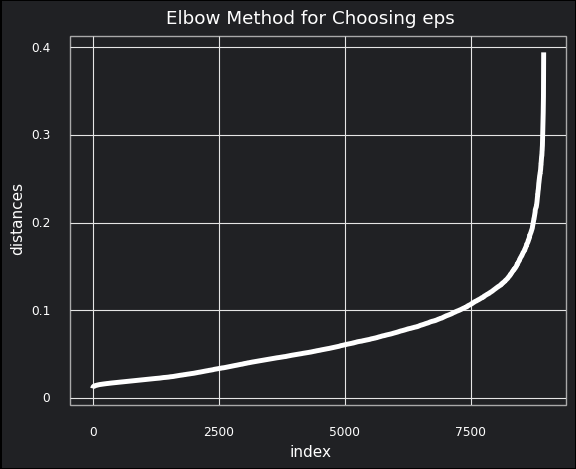

<ggplot: (144874681323)>

In [126]:
# Elbow method

mins = 9
nn = NearestNeighbors(mins + 1)

nn.fit(log_kpca_data)

distances, neighbors = nn.kneighbors(log_kpca_data)

# sort the distances
distances = np.sort(distances[:, mins], axis = 0)

#plot the distances
distances_df = pd.DataFrame({"distances": distances,
                             "index": list(range(0,len(distances)))})
plt = (ggplot(distances_df, aes(x = "index", y = "distances")) +
 geom_line(color = "white", size = 2) + theme_minimal() +
 labs(title = "Elbow Method for Choosing eps") +
 theme(panel_grid_minor = element_blank(),
      rect = element_rect(fill = "#202124ff"),
      axis_text = element_text(color = "white"),
      axis_title = element_text(color = "white"),
      plot_title = element_text(color = "white"),
      panel_border = element_line(color = "darkgray"),
      plot_background = element_rect(fill = "#202124ff")
      ))


plt

In [127]:
# entry point to min points = # features+1
log_kpca_db = DBSCAN(eps =0.13, min_samples = 9).fit(log_kpca_data)
pd.DataFrame(log_kpca_db.labels_).value_counts()

 1    2048
 0    1790
 4    1672
 2    1007
 6     871
 7     714
 5     407
-1     368
 8      52
 3      21
dtype: int64

In [128]:
# calaculate silhout score without noise 
log_kpca_data_copy= log_kpca_data.copy()
log_kpca_data_copy["DBSCAN labels"] = log_kpca_db.labels_

# grab only clustered data points
log_kpca_data_copy_clustered = log_kpca_data_copy.loc[(log_kpca_data_copy["DBSCAN labels"] >= 0)]

silhouette_score(log_kpca_data_copy_clustered.drop("DBSCAN labels", axis=1), log_kpca_data_copy_clustered["DBSCAN labels"])



0.45111629861892455

In [129]:
log_kpca_tsne['DBSCAN label']=log_kpca_db.labels_
log_kpca_tsne['DBSCAN label'].replace(0, "cluster 1", inplace=True)
log_kpca_tsne['DBSCAN label'].replace(1, "cluster 2", inplace=True)
log_kpca_tsne['DBSCAN label'].replace(2, "cluster 3", inplace=True)
log_kpca_tsne['DBSCAN label'].replace(3, "cluster 4", inplace=True)
log_kpca_tsne['DBSCAN label'].replace(4, "cluster 5", inplace=True)
log_kpca_tsne['DBSCAN label'].replace(5, "cluster 6", inplace=True)
log_kpca_tsne['DBSCAN label'].replace(6, "cluster 7", inplace=True)
log_kpca_tsne['DBSCAN label'].replace(7, "cluster 8", inplace=True)
log_kpca_tsne['DBSCAN label'].replace(8, "cluster 9", inplace=True)
log_kpca_tsne['DBSCAN label'].replace(-1, "anomaly", inplace=True)

log_kpca_tsne.head()

,0,1,kmeans label,hier label,DBSCAN label
0,10.638335,-2.702133,cluster 5,cluster 5,cluster 1
1,0.120898,7.002823,cluster 1,cluster 1,cluster 2
2,-3.934813,-10.635413,cluster 2,cluster 2,cluster 3
3,0.376978,-1.149722,cluster 4,cluster 4,cluster 4
4,0.414723,-6.879784,cluster 2,cluster 2,cluster 3


In [130]:
fig=px.scatter(x=log_kpca_tsne[0], y=log_kpca_tsne[1], 
               color=log_kpca_tsne['DBSCAN label'],
               color_discrete_sequence=px.colors.qualitative.T10
              )
fig.update_layout( title_text='Log Transform + Kernel PCA + DBSCAN ,eps =0.13, min_samples = 9 ')
fig.show()

---------------------------

# Conclusion

- clustering is better with the log transformed data
- any type of normalization techniques lowers the performance of clustering
- kernel pca led to better clustering 